In [14]:
import numpy as np
import open3d as o3d

def map_score_to_color(score):
    """ 将分数映射到颜色，分数接近1（异常）映射到红色，接近0（正常）映射到绿色 """
    # 使用简单的线性插值
    return np.array([score, 1.0 - score, 0.0])  # 红色, 绿色, 蓝色

# 加载.npy文件
npy_file_path = '/disk/vanishing_data/du541/voxelpreds/voxelanomaly_scores_frame_1484.png.npy'  # 替换为您的.npy文件路径
point_cloud_np = np.load(npy_file_path)

# 分离XYZ坐标和异常分数
points = point_cloud_np[:, :3]
scores = point_cloud_np[:, 3]

# 根据异常分数计算颜色
colors = np.array([map_score_to_color(score) for score in scores])

# 创建Open3D点云对象
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(points)
pcd.colors = o3d.utility.Vector3dVector(colors)

# 保存为.ply文件
ply_file_path = '/disk/vanishing_data/du541/thesis_plot/voxelanomaly_scores_frame_1484_.png.ply'  # 替换为您希望保存的.ply文件路径
o3d.io.write_point_cloud(ply_file_path, pcd)

print(f"点云数据已保存为PLY格式: {ply_file_path}")



点云数据已保存为PLY格式: /disk/vanishing_data/du541/thesis_plot/voxelanomaly_scores_frame_1484_.png.ply


In [6]:
import numpy as np
import open3d as o3d

# 加载.npy文件
npy_file_path = '/disk/vanishing_data/du541/voxelpreds/voxelanomaly_scores_frame_1.png.npy'  # 替换为您的.npy文件路径
point_cloud_np = np.load(npy_file_path)

# 分离XYZ坐标和额外的属性
points = point_cloud_np[:, :3]
additional_attribute = point_cloud_np[:, 3]

# 可以将额外的属性转换为颜色（例如，灰度到RGB颜色）
colors = np.zeros((additional_attribute.shape[0], 3))
colors[:, 0] = additional_attribute  # 红色通道
colors[:, 1] = additional_attribute  # 绿色通道
colors[:, 2] = additional_attribute  # 蓝色通道

# 创建Open3D点云对象
pcd = o3d.geometry.PointCloud()
pcd.points = o3d.utility.Vector3dVector(points)
pcd.colors = o3d.utility.Vector3dVector(colors)

# 保存为.ply文件
ply_file_path = '/disk/vanishing_data/du541/thesis_plot/voxelanomaly_scores_frame_1.png.ply'  # 替换为您希望保存的.ply文件路径
o3d.io.write_point_cloud(ply_file_path, pcd)

print(f"点云数据已保存为PLY格式: {ply_file_path}")


点云数据已保存为PLY格式: /disk/vanishing_data/du541/thesis_plot/voxelanomaly_scores_frame_1.png.ply


## carla_dataset

In [1]:
import numpy as np
import pprint


# Load the data from .npy file
# data = np.load('/disk/vanishing_data/qw825/carla_dataset_small/trainval/train/Town01/0000/points/points_000000000.npy', allow_pickle=True)
data = np.load('/disk/vanishing_data/qw825/carla_dataset_small/trainval/train/Town01/0000/points_semantic/points_semantic_000000000.npy', allow_pickle=True)


# Check the shape and datatype of the loaded data
print("Shape:", data.shape)
print("Datatype:", data.dtype)

# Print the first few entries or any other inspection you'd like
# print(data)  # This prints the first 5 entries if it's a 1D array. Adjust accordingly for multi-dimensional arrays.
pprint.pprint(data)

Shape: ()
Datatype: object
array({'points_xyz': array([[-9.1679077e+01, -1.4237441e+01,  1.6359270e+01],
       [-9.2291832e+01, -1.4966387e+01,  1.6486115e+01],
       [-9.2914429e+01, -1.5706816e+01,  1.6615780e+01],
       ...,
       [-9.5714843e-01,  1.9218750e-02, -5.5273050e-01],
       [-9.5710933e-01,  1.2812500e-02, -5.5263627e-01],
       [-9.5699215e-01,  6.3671875e-03, -5.5254930e-01]], dtype=float32), 'CosAngel': array([0.6157617 , 0.6110237 , 0.6062563 , ..., 0.6976572 , 0.69777083,
       0.697891  ], dtype=float32), 'ObjIdx': array([  0,   0,   0, ..., 197, 197, 197], dtype=uint32), 'ObjTag': array([ 9,  9,  9, ..., 10, 10, 10], dtype=uint32)},
      dtype=object)


### pcd

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Load the .npy file
data = np.load('/disk/vanishing_data/du541/voxelpreds/voxelanomaly_scores_frame_3.png.npy', allow_pickle=True)

# Extract the dictionary
point_cloud_dict = data.item()

# Access the points_xyz array from the dictionary
points_xyz = point_cloud_dict['points_xyz']

# Create a new figure and subplot with 3D projection
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot using x, y, and z
ax.scatter(points_xyz[:, 0], points_xyz[:, 1], points_xyz[:, 2])

# Set labels
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Show the plot
plt.show()

ValueError: can only convert an array of size 1 to a Python scalar

### AnoVox(Sample)

In [4]:
import open3d as o3d

# Load the .pcd file
pcd = o3d.io.read_point_cloud("/disk/vanishing_data/du541/AnoVox(Sample)/Anovox/Scenario_7bc0952d-843d-4e79-8dda-c64aae39b9a7/PCD/PCD_7235.pcd")
pcd = o3d.io.read_point_cloud("/disk/vanishing_data/du541/AnoVox(Sample)/Anovox/Scenario_7bc0952d-843d-4e79-8dda-c64aae39b9a7/SEMANTIC_PCD/SEMANTIC_PCD_7235.pcd")

# # Visualize the point cloud
# o3d.visualization.draw_geometries([pcd])

# Save the point cloud to a file
o3d.io.write_point_cloud("/disk/vanishing_data/du541/SEMANTIC_output_point_cloud1.ply", pcd)


True

## Image Property Transfer

### Image's Channel Check

In [7]:
from PIL import Image

# Open the image
image_path = '/disk/vanishing_data/du541/anomaly_scores/perceptual_difference_depth.png'  # Replace with your image path
image = Image.open(image_path)

# Get the color mode of the image
color_mode = image.mode

# Determine the number of channels
if color_mode == 'RGB':
    print("This is a 3-channel (RGB) image.")
elif color_mode == 'RGBA':
    print("This is a 4-channel (RGBA) image.")
elif color_mode == 'L':
    print("This is a 1-channel (grayscale) image.")
else:
    print(f"This image is in {color_mode} mode.")


This is a 3-channel (RGB) image.


### convert a RGB image to a single-channel (grayscale) image and normalize its pixel values between 0 and 1

In [11]:
from PIL import Image
import numpy as np

# Open the RGB image
image_path = '/disk/vanishing_data/du541/anomaly_scores/perceptual_difference_depth.png'  # Replace with your image path
rgb_image = Image.open(image_path)

# Convert the image to grayscale
gray_image = rgb_image.convert('L')

# Convert the grayscale image to a NumPy array
gray_array = np.array(gray_image)

# Normalize the pixel values to be between 0 and 1
normalized_array = gray_array / 255.0

# Optional: Convert the normalized array back to an Image object if needed
normalized_image = Image.fromarray((normalized_array * 255).astype(np.uint8))

# Display or save your image
# normalized_image.show()  # to display the image
normalized_image.save('/disk/vanishing_data/du541/anomaly_scores/scores/sample_anomaly_scores.png')  # to save the image


In [1]:
from PIL import Image

# Load the images
source_image = Image.open('/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000000.png')
# target_image = Image.open('/disk/vanishing_data/du541/AnoVox(Sample)/Anovox/Scenario_565449ea-9e41-4cba-875e-fa34c9668f33/RGB_IMG/RGB_IMG_6789.png')
target_image = Image.open('/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000018.png')

# Resize target to match source dimensions
resized_target = target_image.resize(source_image.size)

save_path = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000018.png'

# Save the modified image
resized_target.save(save_path)


In [1]:
from PIL import Image

# Open the image
image = Image.open('/disk/vanishing_data/du541/input_depth_img_960_600/DEPTH_IMG_000006101.png')

# Check if image has alpha channel
if image.mode == 'RGBA':
    print("Image has an alpha channel.")
else:
    print("Image does not have an alpha channel.")

Image does not have an alpha channel.


## Delecting Alpha Channel
### One Image

In [10]:
from PIL import Image

# Open the image
image = Image.open('/disk/vanishing_data/du541/input_depth_img_960_600/DEPTH_IMG_000006101.png')

# Check if image has alpha channel
if image.mode == 'RGBA':
    # Convert the image to RGB mode (removing the alpha channel)
    rgb_image = image.convert('RGB')

    # Save the converted image
    rgb_image.save('/disk/vanishing_data/du541/input_depth_img_960_600/DEPTH_IMG_000006101.png')


### Batch Process for deleting Alpha Channel

In [6]:
import os
from PIL import Image

# Directory containing the images
image_dir = '/disk/vanishing_data/du541/input_image_960_600'

# Iterate through each file in the directory
for filename in os.listdir(image_dir):
    if filename.endswith('.png'):  # Assuming you want to process PNG images
        file_path = os.path.join(image_dir, filename)

        # Open the image
        image = Image.open(file_path)

        # Check if image has alpha channel
        if image.mode == 'RGBA':
            # Convert the image to RGB mode (removing the alpha channel)
            rgb_image = image.convert('RGB')

            # Save the converted image, overwriting the original file
            rgb_image.save(file_path)

print("Alpha channels removed from all images.")


Alpha channels removed from all images.


### Batch Process for Image Property Transfer

In [13]:
# resize one image
from PIL import Image

# Path to the source image (whose size we want to match)
source_image_path = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000000.png'
source_image = Image.open(source_image_path)

# 获取原图的尺寸
original_size = source_image.size

# Path to the image you want to resize
image_to_resize_path = '/disk/vanishing_data/du541/input_depth_img_960_600/DEPTH_IMG_000006101.png'
image_to_resize = Image.open(image_to_resize_path)

# Resize the image
resized_image = image_to_resize.resize(original_size)

# Directory to save resized image
save_dir = '/disk/vanishing_data/du541/input_depth_img_960_600'

# Save the resized image
resized_image.save(os.path.join(save_dir, 'DEPTH_IMG_000006101.png'))


In [3]:
import os
from PIL import Image

# Path to the source image
source_image_path = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000000.png'
source_image = Image.open(source_image_path)

# Base directory containing the scenario folders
base_dir = '/disk/vanishing_data/du541/AnoVox(Sample)/Anovox/'

# Directory to save resized images
save_dir = '/disk/vanishing_data/du541/image'

# List of scenario folders
scenario_folders = [
    'Scenario_7bc0952d-843d-4e79-8dda-c64aae39b9a7/RGB_IMG',
    'Scenario_57495a4f-cb21-4fd8-875f-7f71489d3d74/RGB_IMG',
    'Scenario_565449ea-9e41-4cba-875e-fa34c9668f33/RGB_IMG',
    'Scenario_b4f7cbfa-b634-4940-9d60-41e944135944/RGB_IMG',
    'Scenario_beb3e255-d751-457b-b8f8-1afe89029634/RGB_IMG',
    'Scenario_bf2301a5-379b-4bd3-80aa-d597d41d6410/RGB_IMG',
    'Scenario_bfc1d392-fb70-4d51-a915-2b238690eb5d/RGB_IMG',
    'Scenario_dea2714d-7153-48bb-bfce-129e1ae9ac2d/RGB_IMG',
    'Scenario_ef183332-f895-4456-82ed-370fae4a7e88/RGB_IMG',
    'Scenario_f593e8cb-4fe4-4d1a-845f-d6e8020fa9cc/RGB_IMG'
]

# Counter for image naming
image_counter = 0

# Iterate through each scenario folder
for folder in scenario_folders:
    folder_path = os.path.join(base_dir, folder)
    for filename in os.listdir(folder_path):
        if filename.endswith('.png'):  # check if the file is an image
            file_path = os.path.join(folder_path, filename)
            
            # Open and resize image
            image = Image.open(file_path)
            resized_image = image.resize(source_image.size)

            # Generate new filename
            new_filename = f"image_{image_counter:09d}.png"
            image_counter += 1

            # Save resized image with new filename
            resized_image.save(os.path.join(save_dir, new_filename))

### With Order

In [3]:
import os
from PIL import Image

# Path to the source image
source_image_path = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000000.png'
source_image = Image.open(source_image_path)

# Base directory containing the scenario folders
base_dir = '/disk/vanishing_data/du541/AnoVox(Sample)/Anovox/'

# Directory to save resized images
save_dir = '/disk/vanishing_data/du541/input_depth_img_960_600'

# List of scenario folders
scenario_folders = [
    'Scenario_bfc1d392-fb70-4d51-a915-2b238690eb5d/DEPTH_IMG',
    'Scenario_dea2714d-7153-48bb-bfce-129e1ae9ac2d/DEPTH_IMG',
    'Scenario_ef183332-f895-4456-82ed-370fae4a7e88/DEPTH_IMG',
    'Scenario_f593e8cb-4fe4-4d1a-845f-d6e8020fa9cc/DEPTH_IMG'
]

# Function to extract the numerical part of the filename
def extract_number(filename):
    return int(filename.split('_')[-1].split('.')[0])

# Iterate through each scenario folder
for folder in scenario_folders:
    folder_path = os.path.join(base_dir, folder)
    
    # Get all image files and sort them by their numerical part in the filename
    image_files = [f for f in os.listdir(folder_path) if f.endswith('.png')]
    image_files.sort(key=extract_number)
    
    # Iterate through sorted image files
    for filename in image_files:
        file_path = os.path.join(folder_path, filename)
        
        # Open and resize image
        image = Image.open(file_path)
        resized_image = image.resize(source_image.size)

        # Extract number from filename and create a new filename with the same number
        number = extract_number(filename)
        new_filename = f"DEPTH_IMG_{number:09d}.png"  # Modify the format if needed

        # Save resized image with new filename
        resized_image.save(os.path.join(save_dir, new_filename))


In [2]:
import os

def count_images_in_folder(folder_path):
    # List all files in the directory
    files = os.listdir(folder_path)
    
    # Count and return the number of image files
    image_count = sum(1 for file in files if file.endswith('.png'))
    return image_count

# Example usage:
folder_path = '/disk/vanishing_data/du541/input_image_960_600'
number_of_images = count_images_in_folder(folder_path)
print(f"There are {number_of_images} image files in the folder.")


There are 1850 image files in the folder.


### Commands to exchange two folders' location

In [ ]:
# Step 1: Create a temporary directory
mkdir /disk/vanishing_data/du541/temp_folder

# Step 2: Move the first folder to the temporary directory
mv /disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image /disk/vanishing_data/du541/temp_folder/

# Step 3: Move the second folder to the first folder's original location
mv /disk/vanishing_data/du541/image /disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/

# Step 4: Move the first folder from the temporary location to the second folder's original location
mv /disk/vanishing_data/du541/temp_folder/image /disk/vanishing_data/du541/


### Extract images from .gif

In [1]:
from PIL import Image
import os

def extract_and_save_frames(gif_path, output_folder):
    # Ensure the output folder exists
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Open the GIF file
    with Image.open(gif_path) as gif:
        # Loop over each frame in the gif
        for frame_number in range(gif.n_frames):
            # Specify the frame to work with
            gif.seek(frame_number)

            # Construct the filename for the frame
            frame_filename = os.path.join(output_folder, f"frame_{frame_number}.png")

            # Save the frame
            gif.save(frame_filename, 'PNG')

# Example usage
gif_path = '/disk/vanishing_data/du541/SEMANTIC_anovox_832_320_gif/imageData.gif'
output_folder = '/disk/vanishing_data/du541/SEMANTIC_anovox_832_320_images'
extract_and_save_frames(gif_path, output_folder)


### Batch Processing: extract images from .gif

In [2]:
from PIL import Image
import os

def extract_and_save_frames(gif_path, output_folder, start_frame_index):
    with Image.open(gif_path) as gif:
        for frame_number in range(gif.n_frames):
            # Specify the frame to work with
            gif.seek(frame_number)

            # Construct the filename for the frame
            frame_filename = os.path.join(output_folder, f"frame_{start_frame_index + frame_number}.png")

            # Save the frame
            gif.save(frame_filename, 'PNG')

    return start_frame_index + gif.n_frames

# Directory containing the GIF files
gif_dir = '/disk/vanishing_data/du541/RGB_out_anovox_832_320_gif'
output_folder = '/disk/vanishing_data/du541/RGB_out_anovox_832_320_images'

# Ensure the output folder exists
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Sort the GIF files by their numerical order
gif_files = sorted([f for f in os.listdir(gif_dir) if f.endswith('.gif')],
                   key=lambda x: int(x.split('-')[-1].split('.')[0]))

# Initialize the starting frame index
start_frame_index = 1

# Iterate over each GIF file and extract frames
for gif_file in gif_files:
    gif_path = os.path.join(gif_dir, gif_file)
    start_frame_index = extract_and_save_frames(gif_path, output_folder, start_frame_index)


## .npy file check

In [9]:
import numpy as np

# Path to the .npy file
npy_file_path = '/disk/vanishing_data/du541/voxelpreds/voxelanomaly_scores_frame_11.png.npy'

# Load the data from the .npy file
data = np.load(npy_file_path)

# Print the loaded data
print(data)

# Optionally, check the shape and datatype of the array
print(f"Shape of the array: {data.shape}")
print(f"Datatype of the array: {data.dtype}")


[[5.56000000e+02 4.51000000e+02 2.80000000e+01 7.10629515e-01]
 [5.55000000e+02 4.52000000e+02 2.80000000e+01 7.13071895e-01]
 [5.56000000e+02 4.52000000e+02 2.80000000e+01 6.90799397e-01]
 ...
 [6.64000000e+02 4.80000000e+02 6.10000000e+01 1.05882353e-01]
 [6.63000000e+02 4.78000000e+02 6.20000000e+01 1.13725490e-01]
 [6.62000000e+02 4.79000000e+02 6.20000000e+01 1.05882353e-01]]
Shape of the array: (13307, 4)
Datatype of the array: float64


### Draw the number on image

In [18]:
from PIL import Image, ImageDraw, ImageFont

# Open an existing image
image_path = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/image_000000001.png'
image = Image.open(image_path)

# Prepare drawing context
draw = ImageDraw.Draw(image)

# Use a default PIL font
font_size = 100
font = ImageFont.load_default()

# Specify the text position (x, y) on the image
text_position = (image.width // 2 - font_size, image.height // 2 - font_size)

# Specify the text color
text_color = 'rgb(0, 0, 0)'  # This is white; change as needed

# Draw the text onto the image
draw.text(text_position, '100', fill=text_color, font=font)

# Save the edited image
image.save('/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image/number.png')

# # If you want to display the image in an interactive Python session, you can use:
# image.show()


Error: no "view" rule for type "image/png" passed its test case
       (for more information, add "--debug=1" on the command line)


### Batch Drawing Number

In [22]:
from PIL import Image, ImageDraw, ImageFont
import os

# Base directory containing the images
base_dir = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image'

# Use a default PIL font
font_size = 100
font = ImageFont.load_default()

# Iterate through each image file in the folder
for filename in os.listdir(base_dir):
    if filename.endswith('.png') and filename.startswith('image_'):
        # Extract the number from the filename
        number = filename.split('_')[-1].split('.')[0]

        # Open the image
        image_path = os.path.join(base_dir, filename)
        image = Image.open(image_path)

        # Prepare drawing context
        draw = ImageDraw.Draw(image)

        # Calculate text position
        text_width, text_height = draw.textsize(number, font=font)
        text_position = ((image.width - text_width) // 2, (image.height - text_height) // 2)

        # Specify the text color
        text_color = 'rgb(0, 0, 0)'  # Black color

        # Draw the text onto the image
        draw.text(text_position, number, fill=text_color, font=font)

        # Save the edited image, overwriting the original
        image.save(image_path)

# Note: This will overwrite the original images, so make sure you have backups if needed.


/tmp/fzi-du541/ipykernel_2064991/3052544279.py:25: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(number, font=font)
/tmp/fzi-du541/ipykernel_2064991/3052544279.py:25: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(number, font=font)
/tmp/fzi-du541/ipykernel_2064991/3052544279.py:25: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(number, font=font)
/tmp/fzi-du541/ipykernel_2064991/3052544279.py:25: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(number, font=font)
/tmp/fzi-du541/ipykernel_2064991/3052544279.py:2

In [20]:
from PIL import Image, ImageDraw, ImageFont
import os

# Base directory containing the images
base_dir = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image'

# Use a default PIL font
font_size = 100
font = ImageFont.load_default()

# Iterate through each image file in the folder
for filename in os.listdir(base_dir):
    if filename.endswith('.png') and filename.startswith('image_'):
        # Extract the number from the filename
        number = filename.split('_')[-1].split('.')[0]

        # Open the image
        image_path = os.path.join(base_dir, filename)
        image = Image.open(image_path)

        # Prepare drawing context
        draw = ImageDraw.Draw(image)

        # Calculate text position
        text_bbox = draw.textbbox((0, 0), number, font=font)
        text_width, text_height = text_bbox[2] - text_bbox[0], text_bbox[3] - text_bbox[1]
        text_position = ((image.width - text_width) // 2, (image.height - text_height) // 2)

        # Specify the text color
        text_color = 'rgb(0, 0, 0)'  # Black color

        # Draw the text onto the image
        draw.text(text_position, number, fill=text_color, font=font)

        # Save the edited image, overwriting the original
        image.save(image_path)


KeyboardInterrupt: 

## Print the number of output images

In [ ]:
10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32,
210, 212, 214, 216, 218, 220, 222, 224, 226, 228, 230, 232,
410, 412, 414, 416, 418, 420, 422, 424, 426, 428, 430, 432,
610, 612, 614, 616, 618, 620, 622, 624, 626, 628, 630, 632,
810, 812, 814, 816, 818, 820, 822, 824, 826, 828, 830, 832,
1010, 1012, 1014, 1016, 1018, 1020, 1022, 1024, 1026, 1028, 1030, 1032,
1210, 1212, 1214, 1216, 1218, 1220, 1222, 1224, 1226, 1228, 1230, 1232,
1410, 1412, 1414, 1416, 1418, 1420, 1422, 1424, 1426, 1428, 1430, 1432

In [31]:
sequence_numbers = [
    10, 12, 14, 16, 18, 20, 210, 212, 214, 216, 218, 220, 410, 412, 414, 416, 418, 420, 610, 612, 614, 616, 618, 620, 810, 812, 814, 816, 818, 820, 1010, 1012, 1014, 1016, 1018, 1020, 1210, 1212, 1214, 1216, 1218, 1220, 1410, 1412, 1414, 1416, 1418, 1420
]
print(len(sequence_numbers))

48


## replace the 96 images and run model

In [32]:
import os
import shutil

# 定义要替换的位置的序列号
sequence_numbers = [
    10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32,
    210, 212, 214, 216, 218, 220, 222, 224, 226, 228, 230, 232,
    410, 412, 414, 416, 418, 420, 422, 424, 426, 428, 430, 432,
    610, 612, 614, 616, 618, 620, 622, 624, 626, 628, 630, 632,
    810, 812, 814, 816, 818, 820, 822, 824, 826, 828, 830, 832,
    1010, 1012, 1014, 1016, 1018, 1020, 1022, 1024, 1026, 1028, 1030, 1032,
    1210, 1212, 1214, 1216, 1218, 1220, 1222, 1224, 1226, 1228, 1230, 1232,
    1410, 1412, 1414, 1416, 1418, 1420, 1422, 1424, 1426, 1428, 1430, 1432
    ]

# 定义原始文件夹和目标文件夹路径
original_dir = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image'
target_dir = '/disk/vanishing_data/du541/input_image_960_600'

# 获取目标文件夹中的文件列表，并按文件名数字排序
target_files = sorted([f for f in os.listdir(target_dir) if f.endswith('.png')],
                      key=lambda x: int(x.split('_')[-1].split('.')[0]))

# 每次替换96个特定位置的文件
for i in range(0, len(target_files), 96):
    for j, seq_num in enumerate(sequence_numbers):
        if i + j < len(target_files):
            target_file = target_files[i + j]
            target_path = os.path.join(target_dir, target_file)
            original_file = f'image_{seq_num:09d}.png'
            original_path = os.path.join(original_dir, original_file)

            # 替换文件
            shutil.copy(target_path, original_path)

    # 运行模型
    os.system('python ad_0.py --config mile/configs/predict.yml')


Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

In [3]:
import os
import shutil

# 定义要替换的位置的序列号
sequence_numbers = [
    10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32,
    210, 212, 214, 216, 218, 220, 222, 224, 226, 228, 230, 232,
    410, 412, 414, 416, 418, 420, 422, 424, 426, 428, 430, 432,
    610, 612, 614, 616, 618, 620, 622, 624, 626, 628, 630, 632,
    810, 812, 814, 816, 818, 820, 822, 824, 826, 828, 830, 832,
    1010, 1012, 1014, 1016, 1018, 1020, 1022, 1024, 1026, 1028, 1030, 1032,
    1210, 1212, 1214, 1216, 1218, 1220, 1222, 1224, 1226, 1228, 1230, 1232,
    1410, 1412, 1414, 1416, 1418, 1420, 1422, 1424, 1426, 1428, 1430, 1432
    ]

# 定义原始文件夹和目标文件夹路径
original_dir = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image'
target_dir = '/disk/vanishing_data/du541/input_image_960_600'

# 获取目标文件夹中的文件列表，并按文件名数字排序
target_files = sorted([f for f in os.listdir(target_dir) if f.endswith('.png')],
                      key=lambda x: int(x.split('_')[-1].split('.')[0]))

# 设置最大替换次数
max_iterations = 10  # 您可以根据需要修改这个值

# 计算实际需要处理的文件总数
total_files_to_process = max_iterations * 96

# 每次替换96个特定位置的文件
for i in range(0, total_files_to_process, 96):
    if i >= len(target_files):
        break  # 如果目标文件不足以进行下一次迭代，则停止循环

    for j, seq_num in enumerate(sequence_numbers):
        if i + j < len(target_files):
            target_file = target_files[i + j]
            target_path = os.path.join(target_dir, target_file)
            original_file = f'image_{seq_num:09d}.png'
            original_path = os.path.join(original_dir, original_file)

            # 替换文件
            shutil.copy(target_path, original_path)

    # 运行模型
    os.system('python ad_0.py --config mile/configs/predict.yml')


Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction


Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /dev/shm/fzi-du541/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

In [1]:
# 我想再增加指定从某次开始替换的功能。比如一共有19次替换，比如我想从第5次开始，并进行10次替换，怎么改如下代码

import os
import shutil

# 定义要替换的位置的序列号
sequence_numbers = [
    10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32,
    210, 212, 214, 216, 218, 220, 222, 224, 226, 228, 230, 232,
    410, 412, 414, 416, 418, 420, 422, 424, 426, 428, 430, 432,
    610, 612, 614, 616, 618, 620, 622, 624, 626, 628, 630, 632,
    810, 812, 814, 816, 818, 820, 822, 824, 826, 828, 830, 832,
    1010, 1012, 1014, 1016, 1018, 1020, 1022, 1024, 1026, 1028, 1030, 1032,
    1210, 1212, 1214, 1216, 1218, 1220, 1222, 1224, 1226, 1228, 1230, 1232,
    1410, 1412, 1414, 1416, 1418, 1420, 1422, 1424, 1426, 1428, 1430, 1432
    ]

# 定义原始文件夹和目标文件夹路径
original_dir = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image'
target_dir = '/disk/vanishing_data/du541/input_semantic_img_960_600'

# 获取目标文件夹中的文件列表，并按文件名数字排序
target_files = sorted([f for f in os.listdir(target_dir) if f.endswith('.png')],
                      key=lambda x: int(x.split('_')[-1].split('.')[0]))

# 设置最大替换次数和开始替换的迭代次数
max_iterations = 9  # 替换次数
start_iteration = 10  # 从第5次迭代开始替换

# 计算实际需要处理的文件总数
total_files_to_process = max_iterations * 96
current_iteration = 0  # 当前迭代计数

# 每次替换96个特定位置的文件
for i in range(0, len(target_files), 96):
    current_iteration += 1  # 更新迭代计数

    if current_iteration < start_iteration:
        continue  # 如果当前迭代次数未达到开始值，则跳过此次迭代

    if i >= len(target_files):
        break  # 如果目标文件不足以进行下一次迭代，则停止循环

    for j, seq_num in enumerate(sequence_numbers):
        if i + j < len(target_files):
            target_file = target_files[i + j]
            target_path = os.path.join(target_dir, target_file)
            original_file = f'image_{seq_num:09d}.png'
            original_path = os.path.join(original_dir, original_file)

            # 替换文件
            shutil.copy(target_path, original_path)

    # 运行模型
    os.system('python ad_0.py --config mile/configs/predict.yml')

    if current_iteration > start_iteration + max_iterations -1:
        break  # 达到指定的替换次数后停止

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

### 最后26张图

In [20]:
import os
import shutil

# 定义要替换的位置的序列号
sequence_numbers = [
    10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32,
    210, 212, 214, 216, 218, 220, 222, 224, 226, 228, 230, 232,
    410, 412
]

# 定义原始文件夹和目标文件夹路径
original_dir = '/disk/vanishing_data/du541/carla_dataset_test/trainval/train/Town06/0019/image'
target_dir = '/disk/vanishing_data/du541/input_depth_img_960_600'

# 获取目标文件夹中的文件列表，并按文件名数字排序
target_files = sorted([f for f in os.listdir(target_dir) if f.endswith('.png')],
                      key=lambda x: int(x.split('_')[-1].split('.')[0]))

# 选取最后26张图片
last_26_files = target_files[-26:]

# 替换原始文件夹中特定位置的文件
for j, seq_num in enumerate(sequence_numbers):
    if j < len(last_26_files):
        target_file = last_26_files[j]
        target_path = os.path.join(target_dir, target_file)
        original_file = f'image_{seq_num:09d}.png'
        original_path = os.path.join(original_dir, original_file)

        # 替换文件
        shutil.copy(target_path, original_path)

# 运行模型
os.system('python ad_0.py --config mile/configs/predict.yml')


Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
Filtered 0 runs in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
1466 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/train
2932 data points in /disk/vanishing_data/du541/carla_dataset_test/trainval/val
1466 data points in prediction
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt
Loaded weights from: /disk/vanishing_data/du541/epoch=65-step=99000_.ckpt


Evaluation:   0%|          | 0/8 [00:00<?, ?it/s]/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402421473/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/fzi/ids/du541/no_backup/coding/miniconda3/envs/carla/lib/python3.8/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works

0

## Cropped Images


In [4]:
from PIL import Image
import os

# Source and destination directories
source_dir = '/disk/vanishing_data/du541/input_semantic_img_960_600'
destination_dir = '/disk/vanishing_data/du541/SEMANTIC_anovox_832_320_images'

# Ensure the destination directory exists
if not os.path.exists(destination_dir):
    os.makedirs(destination_dir)

# Crop dimensions (left, top, right, bottom)
crop_dimensions = (64, 138, 896, 458)

# Function to extract the numerical part from the filename
def extract_number(filename):
    return int(''.join(filter(str.isdigit, filename)))

# Sort files by the numerical part in their names
sorted_files = sorted(os.listdir(source_dir), key=extract_number)

# Iterate over sorted files and crop images
for i, filename in enumerate(sorted_files, start=1):
    if filename.endswith('.png'):  # Check if the file is an image
        file_path = os.path.join(source_dir, filename)

        # Open the image and crop it
        with Image.open(file_path) as img:
            cropped_image = img.crop(crop_dimensions)

            # Construct new filename
            new_filename = f"cropped_semantic_images_{i}.png"

            # Save the cropped image to the destination directory
            cropped_image.save(os.path.join(destination_dir, new_filename))

print("Cropping completed.")



Cropping completed.


## Normalization to get the anomaly scores between [0,1]

In [3]:
import cv2
import numpy as np
import os

# Define the input and output directories
input_dir = '/disk/vanishing_data/du541/anomaly_scores/perceptual_difference'
output_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'

# Ensure the output directory exists
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Initialize variables for global min and max
global_min, global_max = float('inf'), -float('inf')

# First, find the global min and max values
for i in range(1, 1851):
    file_name = f'perceptual_difference_{i}.png'
    input_path = os.path.join(input_dir, file_name)
    img = cv2.imread(input_path)
    min_val, max_val = img.min(), img.max()
    global_min, global_max = min(global_min, min_val), max(global_max, max_val)

# Normalize and convert each image
for i in range(1, 1851):
    input_file_name = f'perceptual_difference_{i}.png'
    output_file_name = f'anomaly_scores_frame_{i}.png'  # Updated file name
    input_path = os.path.join(input_dir, input_file_name)
    output_path = os.path.join(output_dir, output_file_name)

    # Read the image
    img = cv2.imread(input_path)

    # Normalize the image using global min and max
    norm_img = (img - global_min) / (global_max - global_min)

    # Convert to grayscale
    gray_img = cv2.cvtColor((norm_img * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)

    # Save the image
    cv2.imwrite(output_path, gray_img)

print("Global normalization and conversion to grayscale completed.")




Global normalization and conversion to grayscale completed.


## Python Script for Creating Binary Masks

In [7]:
import cv2
import numpy as np
import os

semantic_dir = '/disk/vanishing_data/du541/SEMANTIC_anovox_832_320_images'
output_dir = '/disk/vanishing_data/du541/binary_masks'

# Ensure the output directory exists
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for i in range(1, 1851):
    semantic_file_name = f'cropped_semantic_images_{i}.png'  # Update with your naming convention
    semantic_path = os.path.join(semantic_dir, semantic_file_name)
    
    # Read the image in RGB format
    semantic_img = cv2.imread(semantic_path, cv2.IMREAD_COLOR)
    semantic_img = cv2.cvtColor(semantic_img, cv2.COLOR_BGR2RGB)

    # Define the anomaly color and a tolerance
    anomaly_color = np.array([245, 0, 0])
    tolerance = np.array([10, 10, 10])  # This is a tolerance of 10 in all three channels

    # Create the binary mask
    min_color = anomaly_color - tolerance
    max_color = anomaly_color + tolerance
    binary_mask = cv2.inRange(semantic_img, min_color, max_color)

    # Save the binary mask
    binary_mask_path = os.path.join(output_dir, f'binary_mask_{i}.png')
    cv2.imwrite(binary_mask_path, binary_mask)

print("Binary masks have been created.")


Binary masks have been created.


## Python Script for Calculating AUROC

In [8]:
from sklearn.metrics import roc_auc_score

auroc_scores = []

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'

for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(output_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    auroc = roc_auc_score(mask_flat, scores_flat)
    auroc_scores.append(auroc)

average_auroc = sum(auroc_scores) / len(auroc_scores)
print(f"Average AUROC: {average_auroc}")


ValueError: Only one class present in y_true. ROC AUC score is not defined in that case.

In [9]:
from sklearn.metrics import roc_auc_score

auroc_scores = []
anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
output_dir = '/disk/vanishing_data/du541/binary_masks'

# Lists to keep track of images with and without anomalies
images_with_anomalies = []
images_without_anomalies = []

for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(output_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    # Check if both classes are present
    if len(np.unique(mask_flat)) > 1:
        auroc = roc_auc_score(mask_flat, scores_flat)
        auroc_scores.append(auroc)
        images_with_anomalies.append(i)
    else:
        images_without_anomalies.append(i)

# Calculate the average AUROC only if there are scores to average
if auroc_scores:
    average_auroc = sum(auroc_scores) / len(auroc_scores)
    print(f"Average AUROC for images with anomalies: {average_auroc}")
else:
    print("No valid AUROC scores could be calculated because no images with both classes were found.")

# Optionally report on images without anomalies
print(f"Total images with anomalies: {len(images_with_anomalies)}")
print(f"Total images without anomalies: {len(images_without_anomalies)}")


Average AUROC for images with anomalies: 0.88265674455214
Total images with anomalies: 323
Total images without anomalies: 1527


## aupr, fpr95, specificity, f1_score, ppv

In [11]:
from sklearn.metrics import (
    precision_recall_curve, auc, f1_score, precision_score, 
    recall_score, roc_curve
)
import numpy as np
import cv2
import os

def calculate_specificity(y_true, y_pred):
    """
    Calculate specificity (True Negative Rate).
    """
    tn = ((y_true == 0) & (y_pred == 0)).sum()
    fp = ((y_true == 0) & (y_pred == 1)).sum()
    return tn / (tn + fp) if (tn + fp) > 0 else 0

def calculate_fpr_tpr(y_true, y_scores, threshold=0.95):
    """
    Calculate the false positive rate when true positive rate (sensitivity) is at the given threshold.
    """
    fpr, tpr, thresholds = roc_curve(y_true, y_scores)
    # Find the closest true positive rate to the threshold
    closest_tpr_index = np.argmin(np.abs(tpr - threshold))
    return fpr[closest_tpr_index]

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'
output_metrics = {}

# Go through each image and calculate the metrics
for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(binary_masks_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    # Skip if there's only one class present in the ground truth
    if len(np.unique(mask_flat)) == 1:
        continue

    # Precision-Recall Curve and AUPR
    precision, recall, _ = precision_recall_curve(mask_flat, scores_flat)
    aupr = auc(recall, precision)
    
    # F1 Score
    # Binarize predictions based on a threshold (e.g., 0.5)
    predictions = scores_flat >= 0.5
    f1 = f1_score(mask_flat, predictions)
    
    # PPV - Precision Score
    ppv = precision_score(mask_flat, predictions)
    
    # Specificity
    specificity = calculate_specificity(mask_flat, predictions)

    # FPR at 95% TPR
    fpr95 = calculate_fpr_tpr(mask_flat, scores_flat, threshold=0.95)
    
    # Store the metrics for this image
    output_metrics[i] = {
        'AUPR': aupr,
        'F1 Score': f1,
        'PPV': ppv,
        'Specificity': specificity,
        'FPR95': fpr95
    }

# Compute average of the metrics across all images
avg_metrics = {metric: np.mean([metrics[metric] for metrics in output_metrics.values()]) for metric in next(iter(output_metrics.values())).keys()}

print(f"Average AUPR: {avg_metrics['AUPR']}")
print(f"Average F1 Score: {avg_metrics['F1 Score']}")
print(f"Average PPV: {avg_metrics['PPV']}")
print(f"Average Specificity: {avg_metrics['Specificity']}")
print(f"Average FPR at 95% TPR: {avg_metrics['FPR95']}")


Average AUPR: 0.35305000277585286
Average F1 Score: 0.2562426936785212
Average PPV: 0.19321201602747992
Average Specificity: 0.792664480746861
Average FPR at 95% TPR: 0.21947655034111627


### AP

In [2]:
from sklearn.metrics import average_precision_score
import numpy as np
import cv2
import os

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'
ap_scores = []

# Go through each image and calculate the average precision
for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(binary_masks_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    # Skip if there's only one class present in the ground truth
    if len(np.unique(mask_flat)) == 1:
        continue

    # Calculate Average Precision
    ap = average_precision_score(mask_flat, scores_flat)
    ap_scores.append(ap)

# Compute average of the AP across all images
if ap_scores:
    average_ap = sum(ap_scores) / len(ap_scores)
    print(f"Average Precision (AP) across all images: {average_ap}")
else:
    print("No valid AP scores could be calculated due to lack of both classes in the ground truth masks.")


Average Precision (AP) across all images: 0.3520279256985798


### Evaluation with threshold

In [1]:
from sklearn.metrics import precision_recall_curve, auc, f1_score, precision_score, recall_score, roc_curve, roc_auc_score
import numpy as np
import cv2
import os

def calculate_specificity(y_true, y_pred):
    tn = ((y_true == 0) & (y_pred == 0)).sum()
    fp = ((y_true == 0) & (y_pred == 1)).sum()
    return tn / (tn + fp) if (tn + fp) > 0 else 0

def calculate_fpr_tpr(y_true, y_scores, threshold=0.95):
    """
    Calculate the false positive rate when true positive rate (sensitivity) is at the given threshold.
    """
    fpr, tpr, thresholds = roc_curve(y_true, y_scores)
    # Find the closest true positive rate to the threshold
    closest_tpr_index = np.argmin(np.abs(tpr - threshold))
    return fpr[closest_tpr_index]

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'
thresholds = np.linspace(0, 1, 101)  # Creating 101 thresholds from 0 to 1

# Initialize dictionaries to store the metrics for each threshold
metrics_threshold = {thr: {'AUPR': [], 'F1 Score': [], 'PPV': [], 'Specificity': [], 'FPR95': []} for thr in thresholds}

# Go through each image and calculate the metrics
for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(binary_masks_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    # Skip if there's only one class present in the ground truth
    if len(np.unique(mask_flat)) == 1:
        continue

    # Calculate metrics for each threshold
    for thr in thresholds:
        predictions = scores_flat >= thr
        precision, recall, _ = precision_recall_curve(mask_flat, predictions)
        aupr = auc(recall, precision)
        f1 = f1_score(mask_flat, predictions)
        ppv = precision_score(mask_flat, predictions)
        specificity = calculate_specificity(mask_flat, predictions)
        fpr95 = calculate_fpr_tpr(mask_flat, scores_flat, thr)  # Use the current threshold

        metrics_threshold[thr]['AUPR'].append(aupr)
        metrics_threshold[thr]['F1 Score'].append(f1)
        metrics_threshold[thr]['PPV'].append(ppv)
        metrics_threshold[thr]['Specificity'].append(specificity)
        metrics_threshold[thr]['FPR95'].append(fpr95)

# Calculate average of the metrics for each threshold
avg_metrics_threshold = {thr: {metric: np.mean(values) for metric, values in metrics.items()} for thr, metrics in metrics_threshold.items()}

# Example to print average metrics for a specific threshold
threshold_to_check = 0.5  # You can modify this to see results for different thresholds
print(f"Metrics for threshold {threshold_to_check}:")
for metric, value in avg_metrics_threshold[threshold_to_check].items():
    print(f"Average {metric}: {value}")

# Print average metrics for each threshold
for thr, metrics in avg_metrics_threshold.items():
    print(f"Metrics for threshold {thr:.2f}:")
    for metric, value in metrics.items():
        print(f"  Average {metric}: {value:.4f}")
    print()  # Adds a newline for better readability


Metrics for threshold 0.5:
Average AUPR: 0.5037235814735619
Average F1 Score: 0.2562426936785212
Average PPV: 0.19321201602747992
Average Specificity: 0.792664480746861
Average FPR95: 0.10262084958014672
Metrics for threshold 0.00:
  Average AUPR: 0.5240
  Average F1 Score: 0.0868
  Average PPV: 0.0479
  Average Specificity: 0.0000
  Average FPR95: 0.0000

Metrics for threshold 0.01:
  Average AUPR: 0.5241
  Average F1 Score: 0.0873
  Average PPV: 0.0482
  Average Specificity: 0.0048
  Average FPR95: 0.0227

Metrics for threshold 0.02:
  Average AUPR: 0.5246
  Average F1 Score: 0.0891
  Average PPV: 0.0493
  Average Specificity: 0.0236
  Average FPR95: 0.0390

Metrics for threshold 0.03:
  Average AUPR: 0.5252
  Average F1 Score: 0.0908
  Average PPV: 0.0504
  Average Specificity: 0.0420
  Average FPR95: 0.0451

Metrics for threshold 0.04:
  Average AUPR: 0.5262
  Average F1 Score: 0.0940
  Average PPV: 0.0524
  Average Specificity: 0.0738
  Average FPR95: 0.0489

Metrics for threshold

In [1]:
from sklearn.metrics import (
    precision_recall_curve, auc, f1_score, precision_score, 
    recall_score, roc_curve, roc_auc_score, average_precision_score
)
import numpy as np
import cv2
import os

def calculate_specificity(y_true, y_pred):
    tn = ((y_true == 0) & (y_pred == 0)).sum()
    fp = ((y_true == 0) & (y_pred == 1)).sum()
    return tn / (tn + fp) if (tn + fp) > 0 else 0

def calculate_fpr_tpr(y_true, y_scores, threshold=0.95):
    """
    Calculate the false positive rate when true positive rate (sensitivity) is at the given threshold.
    """
    fpr, tpr, thresholds = roc_curve(y_true, y_scores)
    # Find the closest true positive rate to the threshold
    closest_tpr_index = np.argmin(np.abs(tpr - threshold))
    return fpr[closest_tpr_index]

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'
thresholds = np.linspace(0, 1, 101)  # Creating 101 thresholds from 0 to 1

# Initialize dictionaries to store the metrics for each threshold
metrics_threshold = {thr: {'AUROC': [], 'AP': [], 'AUPR': [], 'F1 Score': [], 'PPV': [], 'Specificity': [], 'FPR95': []} for thr in thresholds}

# Go through each image and calculate the metrics
for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(binary_masks_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    # Skip if there's only one class present in the ground truth
    if len(np.unique(mask_flat)) == 1:
        continue

    # Calculate AUROC and AP
    auroc = roc_auc_score(mask_flat, scores_flat)
    ap = average_precision_score(mask_flat, scores_flat)

    # Calculate metrics for each threshold
    for thr in thresholds:
        predictions = scores_flat >= thr
        precision, recall, _ = precision_recall_curve(mask_flat, predictions)
        aupr = auc(recall, precision)
        f1 = f1_score(mask_flat, predictions)
        ppv = precision_score(mask_flat, predictions)
        specificity = calculate_specificity(mask_flat, predictions)
        fpr95 = calculate_fpr_tpr(mask_flat, scores_flat, thr)  # Use the current threshold

        # Store the metrics for this threshold
        metrics_threshold[thr]['AUROC'].append(auroc)
        metrics_threshold[thr]['AP'].append(ap)
        metrics_threshold[thr]['AUPR'].append(aupr)
        metrics_threshold[thr]['F1 Score'].append(f1)
        metrics_threshold[thr]['PPV'].append(ppv)
        metrics_threshold[thr]['Specificity'].append(specificity)
        metrics_threshold[thr]['FPR95'].append(fpr95)

# Calculate average of the metrics for each threshold
avg_metrics_threshold = {thr: {metric: np.mean(values) for metric, values in metrics.items()} for thr, metrics in metrics_threshold.items()}

# Print average metrics for each threshold
for thr, metrics in avg_metrics_threshold.items():
    print(f"Metrics for threshold {thr:.2f}:")
    for metric, value in metrics.items():
        print(f"  Average {metric}: {value:.4f}")
    print()  # Adds a newline for better readability


Metrics for threshold 0.00:
  Average AUROC: 0.8827
  Average AP: 0.3520
  Average AUPR: 0.5240
  Average F1 Score: 0.0868
  Average PPV: 0.0479
  Average Specificity: 0.0000
  Average FPR95: 0.0000

Metrics for threshold 0.01:
  Average AUROC: 0.8827
  Average AP: 0.3520
  Average AUPR: 0.5241
  Average F1 Score: 0.0873
  Average PPV: 0.0482
  Average Specificity: 0.0048
  Average FPR95: 0.0227

Metrics for threshold 0.02:
  Average AUROC: 0.8827
  Average AP: 0.3520
  Average AUPR: 0.5246
  Average F1 Score: 0.0891
  Average PPV: 0.0493
  Average Specificity: 0.0236
  Average FPR95: 0.0390

Metrics for threshold 0.03:
  Average AUROC: 0.8827
  Average AP: 0.3520
  Average AUPR: 0.5252
  Average F1 Score: 0.0908
  Average PPV: 0.0504
  Average Specificity: 0.0420
  Average FPR95: 0.0451

Metrics for threshold 0.04:
  Average AUROC: 0.8827
  Average AP: 0.3520
  Average AUPR: 0.5262
  Average F1 Score: 0.0940
  Average PPV: 0.0524
  Average Specificity: 0.0738
  Average FPR95: 0.0489



### Anomalies Only: AUROC, AUPR, FPR95, AP 

In [2]:
from sklearn.metrics import (
    precision_recall_curve, auc, f1_score, precision_score, 
    recall_score, roc_curve, roc_auc_score, average_precision_score
)
import numpy as np
import cv2
import os

def calculate_fpr_at_tpr(y_true, y_scores, target_tpr=0.95):
    """Calculate the false positive rate when the true positive rate is at the target value."""
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    fpr_at_target_tpr = fpr[np.where(tpr >= target_tpr)[0][0]]
    return fpr_at_target_tpr

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'

auroc_scores, aupr_scores, fpr95_scores, ap_scores = [], [], [], []

# Loop through each image and calculate the metrics
for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(binary_masks_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    # Flatten the images to one-dimensional arrays
    scores_flat = anomaly_score_img.flatten()
    mask_flat = binary_mask.flatten()

    # Skip images with only one class present in the ground truth
    if len(np.unique(mask_flat)) == 1:
        continue

    # Calculate AUROC
    auroc = roc_auc_score(mask_flat, scores_flat)
    auroc_scores.append(auroc)

    # Calculate AUPR
    precision, recall, _ = precision_recall_curve(mask_flat, scores_flat)
    aupr = auc(recall, precision)
    aupr_scores.append(aupr)

    # Calculate FPR95
    fpr95 = calculate_fpr_at_tpr(mask_flat, scores_flat)
    fpr95_scores.append(fpr95)

    # Calculate AP
    ap = average_precision_score(mask_flat, scores_flat)
    ap_scores.append(ap)

# Compute the average of the metrics
average_auroc = np.mean(auroc_scores)
average_aupr = np.mean(aupr_scores)
average_fpr95 = np.mean(fpr95_scores)
average_ap = np.mean(ap_scores)

# Print the average metrics
print(f"Average AUROC: {average_auroc}")
print(f"Average AUPR: {average_aupr}")
print(f"Average FPR95: {average_fpr95}")
print(f"Average AP: {average_ap}")


Average AUROC: 0.8826567445521399
Average AUPR: 0.35305000277585286
Average FPR95: 0.22254616784722586
Average AP: 0.35202792569858


### Anomalies Only: f1_score, precision_score, recall_score, roc_curve

In [ ]:
from sklearn.metrics import f1_score, precision_score, recall_score, roc_curve
import numpy as np
import cv2
import os

def calculate_specificity(y_true, y_pred):
    """Calculate the specificity (True Negative Rate)."""
    tn = ((y_true == 0) & (y_pred == 0)).sum()
    fp = ((y_true == 0) & (y_pred == 1)).sum()
    return tn / (tn + fp) if (tn + fp) > 0 else 0

anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'

all_scores_flat, all_masks_flat = [], []

# Loop through each image
for i in range(1, 1851):
    anomaly_score_path = os.path.join(anomaly_scores_dir, f'anomaly_scores_frame_{i}.png')
    binary_mask_path = os.path.join(binary_masks_dir, f'binary_mask_{i}.png')

    anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
    binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

    all_scores_flat.extend(anomaly_score_img.flatten())
    all_masks_flat.extend(binary_mask.flatten())

# Convert lists to numpy arrays
all_scores_flat = np.array(all_scores_flat)
all_masks_flat = np.array(all_masks_flat)

# Initialize dictionaries to store metrics for each threshold
thresholds = np.linspace(0, 1, 101)
metrics_threshold = {thr: {'F1 Score': None, 'PPV': None, 'Specificity': None} for thr in thresholds}

# Calculate metrics for each threshold
for thr in thresholds:
    predictions = (all_scores_flat >= thr).astype(np.int)
    f1 = f1_score(all_masks_flat, predictions)
    ppv = precision_score(all_masks_flat, predictions)
    specificity = calculate_specificity(all_masks_flat, predictions)

    metrics_threshold[thr]['F1 Score'] = f1
    metrics_threshold[thr]['PPV'] = ppv
    metrics_threshold[thr]['Specificity'] = specificity

# Output the results for each threshold
for thr, metrics in metrics_threshold.items():
    print(f"Metrics for threshold {thr:.2f}: F1 Score = {metrics['F1 Score']}, "
          f"PPV = {metrics['PPV']}, Specificity = {metrics['Specificity']}")


### Normality_Included:  AUROC, AUPR, FPR95, AP 

In [2]:
import os
import random
import cv2
import numpy as np
from sklearn.metrics import roc_auc_score, precision_recall_curve, auc, roc_curve, average_precision_score

# 设定文件路径
anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'

# 检查掩码图像以确定异常
def contains_anomaly(mask_image):
    return np.any(mask_image == 255)  # 假设异常像素值为255

# 获取文件列表
anomaly_images = []  # 填充含异常值的图片路径
normal_images = []   # 填充不含异常值的图片路径

# 遍历掩码目录中的所有文件
for filename in os.listdir(binary_masks_dir):
    if filename.endswith(".png"):  # 假设所有掩码文件都是PNG格式
        mask_path = os.path.join(binary_masks_dir, filename)
        mask_image = cv2.imread(mask_path, 0)  # 以灰度模式读取
        
        # 根据掩码图像判断图片类别
        if contains_anomaly(mask_image):
            anomaly_images.append(filename.replace('binary_mask_', 'anomaly_scores_frame_'))
        else:
            normal_images.append(filename.replace('binary_mask_', 'anomaly_scores_frame_'))

# 分配不含异常值的图片到含异常值的图片
batch_size = 3  # 减小每批处理的图片数
batches = []

for anomaly_image in anomaly_images:
    batch = [anomaly_image]
    batch.extend(random.sample(normal_images, batch_size - 1))
    batches.append(batch)

# 初始化用于聚合的变量
aggregate_auroc = []
aggregate_aupr = []
aggregate_fpr95 = []
aggregate_ap = []

# 处理每个批次
for batch in batches:
    scores_flat = []
    masks_flat = []

    for image_path in batch:
        anomaly_score_path = os.path.join(anomaly_scores_dir, image_path)
        binary_mask_path = os.path.join(binary_masks_dir, image_path.replace('anomaly_scores_frame_', 'binary_mask_'))

        anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
        binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

        scores_flat.extend(anomaly_score_img.flatten())
        masks_flat.extend(binary_mask.flatten())

    # 将列表转换为NumPy数组
    scores_flat = np.array(scores_flat)
    masks_flat = np.array(masks_flat)

    # 计算并聚合每个批次的指标
    auroc = roc_auc_score(masks_flat, scores_flat)
    precision, recall, _ = precision_recall_curve(masks_flat, scores_flat)
    aupr = auc(recall, precision)
    fpr, tpr, _ = roc_curve(masks_flat, scores_flat)
    fpr95 = fpr[np.where(tpr >= 0.95)[0][0]]
    ap = average_precision_score(masks_flat, scores_flat)

    aggregate_auroc.append(auroc)
    aggregate_aupr.append(aupr)
    aggregate_fpr95.append(fpr95)
    aggregate_ap.append(ap)

# 计算整体平均指标
average_auroc = np.mean(aggregate_auroc)
average_aupr = np.mean(aggregate_aupr)
average_fpr95 = np.mean(aggregate_fpr95)
average_ap = np.mean(aggregate_ap)

# 输出结果
print(f"Average AUROC: {average_auroc}")
print(f"Average AUPR: {average_aupr}")
print(f"Average FPR95: {average_fpr95}")
print(f"Average AP: {average_ap}")


Average AUROC: 0.8605301660635838
Average AUPR: 0.12818868938587663
Average FPR95: 0.2645874493574433
Average AP: 0.12748608174054005


In [2]:
import os
import random
import cv2
import numpy as np
from sklearn.metrics import f1_score, precision_score, recall_score, roc_curve

def calculate_specificity(y_true, y_pred):
    """Calculate the specificity (True Negative Rate)."""
    tn = ((y_true == 0) & (y_pred == 0)).sum()
    fp = ((y_true == 0) & (y_pred == 1)).sum()
    return tn / (tn + fp) if (tn + fp) > 0 else 0

# 设定文件路径
anomaly_scores_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
binary_masks_dir = '/disk/vanishing_data/du541/binary_masks'

# 初始化阈值列表和结果字典
thresholds = np.linspace(0, 1, 101)
metrics_threshold = {thr: {'F1 Score': [], 'PPV': [], 'Specificity': []} for thr in thresholds}

# 检查掩码图像以确定异常
def contains_anomaly(mask_image):
    return np.any(mask_image == 255)  # 假设异常像素值为255

# 获取文件列表
anomaly_images = []  # 填充含异常值的图片路径
normal_images = []   # 填充不含异常值的图片路径

# 遍历掩码目录中的所有文件
for filename in os.listdir(binary_masks_dir):
    if filename.endswith(".png"):  # 假设所有掩码文件都是PNG格式
        mask_path = os.path.join(binary_masks_dir, filename)
        mask_image = cv2.imread(mask_path, 0)  # 以灰度模式读取
        
        # 根据掩码图像判断图片类别
        if contains_anomaly(mask_image):
            anomaly_images.append(filename.replace('binary_mask_', 'anomaly_scores_frame_'))
        else:
            normal_images.append(filename.replace('binary_mask_', 'anomaly_scores_frame_'))


batch_size = 3  # 减小每批处理的图片数
batches = []

# 创建批次
for anomaly_image in anomaly_images:
    batch = [anomaly_image]
    batch.extend(random.sample(normal_images, batch_size - 1))
    batches.append(batch)

# 处理每个批次
for batch in batches:
    scores_flat = []
    masks_flat = []

    for image_path in batch:
        anomaly_score_path = os.path.join(anomaly_scores_dir, image_path)
        binary_mask_path = os.path.join(binary_masks_dir, image_path.replace('anomaly_scores_frame_', 'binary_mask_'))

        anomaly_score_img = cv2.imread(anomaly_score_path, 0) / 255.0
        binary_mask = cv2.imread(binary_mask_path, 0) / 255.0

        scores_flat.extend(anomaly_score_img.flatten())
        masks_flat.extend(binary_mask.flatten())

    scores_flat = np.array(scores_flat)
    masks_flat = np.array(masks_flat)

    # 计算每个阈值下的指标
    for thr in thresholds:
        predictions = (scores_flat >= thr).astype(np.int)
        f1 = f1_score(masks_flat, predictions)
        ppv = precision_score(masks_flat, predictions)
        specificity = calculate_specificity(masks_flat, predictions)

        metrics_threshold[thr]['F1 Score'].append(f1)
        metrics_threshold[thr]['PPV'].append(ppv)
        metrics_threshold[thr]['Specificity'].append(specificity)

# 计算每个阈值的平均指标
for thr in thresholds:
    metrics_threshold[thr]['F1 Score'] = np.mean(metrics_threshold[thr]['F1 Score'])
    metrics_threshold[thr]['PPV'] = np.mean(metrics_threshold[thr]['PPV'])
    metrics_threshold[thr]['Specificity'] = np.mean(metrics_threshold[thr]['Specificity'])

# 输出结果
for thr, metrics in metrics_threshold.items():
    print(f"Threshold {thr:.2f}: F1 Score = {metrics['F1 Score']}, PPV = {metrics['PPV']}, Specificity = {metrics['Specificity']}")


/tmp/fzi-du541/ipykernel_2169806/59142483.py:71: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  predictions = (scores_flat >= thr).astype(np.int)
/tmp/fzi-du541/ipykernel_2169806/59142483.py:71: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional i

Threshold 0.00: F1 Score = 0.03087664647041878, PPV = 0.015980910013296816, Specificity = 0.0
Threshold 0.01: F1 Score = 0.030990742166135336, PPV = 0.016041953692914678, Specificity = 0.0035602102439226753
Threshold 0.02: F1 Score = 0.031460660190328775, PPV = 0.016293815059185396, Specificity = 0.017851534112382966
Threshold 0.03: F1 Score = 0.031931557213454406, PPV = 0.01654663572152322, Specificity = 0.0319268563482973
Threshold 0.04: F1 Score = 0.032810499341152745, PPV = 0.017019335268370666, Specificity = 0.057466438331267106
Threshold 0.05: F1 Score = 0.03348018621847091, PPV = 0.01738024674239613, Specificity = 0.07600206426623175
Threshold 0.06: F1 Score = 0.03487505953675948, PPV = 0.018134389078451642, Specificity = 0.11231155804803573
Threshold 0.07: F1 Score = 0.0361023108314495, PPV = 0.018800357709164675, Specificity = 0.1420118058919161
Threshold 0.08: F1 Score = 0.03826489686121123, PPV = 0.019980081631007444, Specificity = 0.19053943829588219
Threshold 0.09: F1 Scor

## Padding and resize from 832 * 320 to 768 * 512

In [1]:
from PIL import Image
import numpy as np
import os

# Source and destination directories
source_dir = '/disk/vanishing_data/du541/anomaly_scores/scores'
destination_dir = '/disk/vanishing_data/du541/anomaly_scores/768_512_scores_anovox'

# # Ensure the destination directory exists
# if not os.path.exists(destination_dir):
#     os.makedirs(destination_dir)

# Original and cropped dimensions
original_size = (960, 600)
crop_dimensions = (64, 138, 896, 458)  # left, top, right, bottom

# New size after resizing
new_size = (768, 512)

# Padding values
left_pad, top_pad = crop_dimensions[0], crop_dimensions[1]
right_pad, bottom_pad = original_size[0] - crop_dimensions[2], original_size[1] - crop_dimensions[3]

# Padding value (grey value)
padding_value = int(0.5 * 255)  # Grey value scaled to 0-255

# Iterate over each file in the source directory
for i in range(1, 1851):  # Assuming filenames are like 'anomaly_scores_frame_i.png'
    filename = f'anomaly_scores_frame_{i}.png'
    file_path = os.path.join(source_dir, filename)

    # Open the image
    with Image.open(file_path) as img:
        # Convert the image to numpy array for easier manipulation
        img_array = np.array(img)

        # Create a new array with the original size and the padding value
        new_img_array = np.full((original_size[1], original_size[0]), padding_value, dtype=np.uint8)

        # Place the cropped image into the new array
        new_img_array[top_pad:top_pad + img_array.shape[0], left_pad:left_pad + img_array.shape[1]] = img_array

        # Convert back to PIL image
        new_img = Image.fromarray(new_img_array)

        # Resize the image
        resized_img = new_img.resize(new_size, Image.ANTIALIAS)

        # Save the resized image to the destination directory
        resized_img.save(os.path.join(destination_dir, filename))

print("Padding and resizing completed.")


/tmp/fzi-du541/ipykernel_1828255/3827335587.py:47: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  resized_img = new_img.resize(new_size, Image.ANTIALIAS)


Padding and resizing completed.


### Image pixel value check 

In [6]:
from PIL import Image

# Load the image
image_path = '/disk/vanishing_data/du541/binary_masks/binary_mask_1.png'  # Replace with your image path
image = Image.open(image_path)

# Pixel coordinates (x, y)
x, y = 400, 300  # Replace with the coordinates of the pixel you're interested in

# Get the pixel value
pixel_value = image.getpixel((x, y))

# Print the pixel value
print(f"Pixel value at ({x}, {y}): {pixel_value}")


Pixel value at (400, 300): 255


In [5]:
from PIL import Image

# Load the image
image_path = '/disk/vanishing_data/du541/binary_masks/binary_mask_1.png'  # Replace with your image path
image = Image.open(image_path)

# Get image dimensions
width, height = image.size

# Iterate over each pixel
for y in range(height):
    for x in range(width):
        pixel_value = image.getpixel((x, y))
        print(f"Pixel value at ({x}, {y}): {pixel_value}")


Pixel value at (0, 0): 0
Pixel value at (1, 0): 0
Pixel value at (2, 0): 0
Pixel value at (3, 0): 0
Pixel value at (4, 0): 0
Pixel value at (5, 0): 0
Pixel value at (6, 0): 0
Pixel value at (7, 0): 0
Pixel value at (8, 0): 0
Pixel value at (9, 0): 0
Pixel value at (10, 0): 0
Pixel value at (11, 0): 0
Pixel value at (12, 0): 0
Pixel value at (13, 0): 0
Pixel value at (14, 0): 0
Pixel value at (15, 0): 0
Pixel value at (16, 0): 0
Pixel value at (17, 0): 0
Pixel value at (18, 0): 0
Pixel value at (19, 0): 0
Pixel value at (20, 0): 0
Pixel value at (21, 0): 0
Pixel value at (22, 0): 0
Pixel value at (23, 0): 0
Pixel value at (24, 0): 0
Pixel value at (25, 0): 0
Pixel value at (26, 0): 0
Pixel value at (27, 0): 0
Pixel value at (28, 0): 0
Pixel value at (29, 0): 0
Pixel value at (30, 0): 0
Pixel value at (31, 0): 0
Pixel value at (32, 0): 0
Pixel value at (33, 0): 0
Pixel value at (34, 0): 0
Pixel value at (35, 0): 0
Pixel value at (36, 0): 0
Pixel value at (37, 0): 0
Pixel value at (38, 0)

In [16]:
from PIL import Image
import os

def contains_two_pixel_values(image_path):
    """ 检查图像是否包含0和1两种像素值 """
    with Image.open(image_path) as img:
        pixels = list(img.getdata())
        return set(pixels) == {0, 255}

# 指定包含图像的目录
directory_path = '/disk/vanishing_data/du541/binary_masks'

# 检查目录中的每个文件
for filename in os.listdir(directory_path):
    file_path = os.path.join(directory_path, filename)
    if file_path.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif', '.tiff')):  # 添加其他格式如果需要
        if contains_two_pixel_values(file_path):
            print(filename)


binary_mask_29.png
binary_mask_564.png
binary_mask_1122.png
binary_mask_1683.png
binary_mask_401.png
binary_mask_758.png
binary_mask_774.png
binary_mask_582.png
binary_mask_573.png
binary_mask_1684.png
binary_mask_1111.png
binary_mask_934.png
binary_mask_1499.png
binary_mask_197.png
binary_mask_578.png
binary_mask_757.png
binary_mask_1500.png
binary_mask_779.png
binary_mask_15.png
binary_mask_558.png
binary_mask_1481.png
binary_mask_376.png
binary_mask_1124.png
binary_mask_1320.png
binary_mask_781.png
binary_mask_391.png
binary_mask_748.png
binary_mask_742.png
binary_mask_398.png
binary_mask_1315.png
binary_mask_589.png
binary_mask_1316.png
binary_mask_790.png
binary_mask_399.png
binary_mask_932.png
binary_mask_592.png
binary_mask_1303.png
binary_mask_584.png
binary_mask_204.png
binary_mask_402.png
binary_mask_1112.png
binary_mask_560.png
binary_mask_793.png
binary_mask_192.png
binary_mask_1309.png
binary_mask_943.png
binary_mask_1501.png
binary_mask_1121.png
binary_mask_1666.png
binar

In [19]:
from PIL import Image
import os
import re

def contains_two_pixel_values(image_path):
    """检查图像是否包含0和1两种像素值"""
    with Image.open(image_path) as img:
        pixels = list(img.getdata())
        return set(pixels) == {0, 255}

def extract_number(filename):
    """从文件名中提取数字"""
    match = re.search(r'\d+', filename)
    return int(match.group()) if match else 0

# 图像文件夹路径
folder_path = '/disk/vanishing_data/du541/binary_masks'

# 获取所有图像文件名
image_files = sorted(os.listdir(folder_path), key=extract_number)

# 找出包含两种像素值的图像
images_with_two_pixel_values = [f for f in image_files if contains_two_pixel_values(os.path.join(folder_path, f))]

# 输出文件名
for image_file in images_with_two_pixel_values:
    print(image_file)



binary_mask_1.png
binary_mask_2.png
binary_mask_3.png
binary_mask_4.png
binary_mask_5.png
binary_mask_6.png
binary_mask_7.png
binary_mask_8.png
binary_mask_9.png
binary_mask_10.png
binary_mask_11.png
binary_mask_12.png
binary_mask_13.png
binary_mask_14.png
binary_mask_15.png
binary_mask_16.png
binary_mask_17.png
binary_mask_18.png
binary_mask_19.png
binary_mask_20.png
binary_mask_21.png
binary_mask_22.png
binary_mask_23.png
binary_mask_24.png
binary_mask_25.png
binary_mask_26.png
binary_mask_27.png
binary_mask_28.png
binary_mask_29.png
binary_mask_30.png
binary_mask_31.png
binary_mask_32.png
binary_mask_33.png
binary_mask_34.png
binary_mask_35.png
binary_mask_36.png
binary_mask_37.png
binary_mask_38.png
binary_mask_39.png
binary_mask_40.png
binary_mask_41.png
binary_mask_42.png
binary_mask_43.png
binary_mask_44.png
binary_mask_45.png
binary_mask_46.png
binary_mask_47.png
binary_mask_48.png
binary_mask_49.png
binary_mask_50.png
binary_mask_51.png
binary_mask_186.png
binary_mask_187.png


In [20]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def get_image_pixel_values(image_path):
    """ 读取图像并返回其像素值 """
    with Image.open(image_path) as img:
        return np.array(img).flatten()

# 图像文件夹路径
folder_path = '/disk/vanishing_data/du541/anomaly_scores/perceptual_difference'

# 获取所有图像文件名
image_files = sorted(os.listdir(folder_path), key=lambda x: int(x.split('_')[-1].split('.')[0]))

# 存储所有像素值
all_pixels = []

# 遍历图像文件并提取像素值
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    pixels = get_image_pixel_values(image_path)
    all_pixels.extend(pixels)

# 绘制分布图
plt.hist(all_pixels, bins=50, color='blue', alpha=0.7)
plt.title('Pixel Value Distribution')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.show()

123

: 

: 

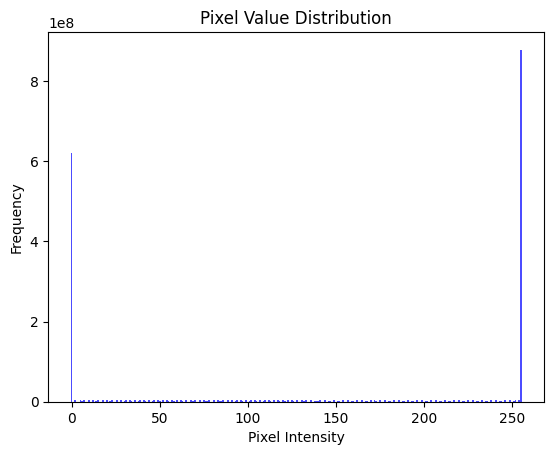

In [3]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def get_image_pixel_values(image_path):
    """ 读取图像并返回其像素值 """
    with Image.open(image_path) as img:
        return np.array(img).flatten()

# 图像文件夹路径
folder_path = '/disk/vanishing_data/du541/anomaly_scores/perceptual_difference'

# 获取所有图像文件名
image_files = sorted(os.listdir(folder_path), key=lambda x: int(x.split('_')[-1].split('.')[0]))

# 初始化直方图的bins和值
hist_bins = np.linspace(0, 256, 257)  # 包含256个边界的257个点
hist_values = np.zeros(256, dtype=int)  # 256个bins对应的值

# 分批遍历图像文件并更新直方图
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    pixels = get_image_pixel_values(image_path)
    hist, _ = np.histogram(pixels, bins=hist_bins)
    hist_values += hist

# 绘制分布图
plt.bar(hist_bins[:-1], hist_values, width=1, color='blue', alpha=0.7)
plt.title('Pixel Value Distribution')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.show()



# synchronization check 